<a href="https://colab.research.google.com/github/josephfriedel/AAI-510-TEAM-03/blob/main/AAI_510_final_project_062324a1.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
pip install xgboost

In [2]:
from sklearn import tree # Import Tree Classifiers
from sklearn.ensemble import RandomForestClassifier # Import Random Forest Classifiers
from sklearn.model_selection import train_test_split,  RandomizedSearchCV # Import train_test_split function
from sklearn import metrics # Import scikit-learn metrics module for accuracy calculation
from scipy.stats import randint # Generate random numbers
from xgboost import XGBClassifier, plot_importance
import pandas as pd
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler
import numpy as np
import seaborn as sns
import pandas as pd
import matplotlib.pyplot as plt
from scipy import stats
from scipy.stats import norm, skew
from sklearn.linear_model import LogisticRegression

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


In [4]:
!pip install dataprep --quiet

In [5]:
from dataprep.eda import *
from dataprep.datasets import load_dataset
from dataprep.eda import plot, plot_correlation, plot_missing, plot_diff, create_report

In [6]:
# if working on your own colab/jupyter, replace this path with where you stored the data.
#df = pd.read_csv("/content/drive/MyDrive/Colab Notebooks/Datasets/AAI-510/Project/weatherAUS.csv")
df = pd.read_csv("AUS_Weather.csv")
shap = df.shape
print("Shape of the dataframe (row, col):",shap,"\r\n")

df

Shape of the dataframe (row, col): (145460, 23) 



,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,12/1/2008,Albury,13.4,22.9,0.6,NaN,NaN,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,NaN,16.9,21.8,No,No
1,12/2/2008,Albury,7.4,25.1,0.0,NaN,NaN,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,NaN,NaN,17.2,24.3,No,No
2,12/3/2008,Albury,12.9,25.7,0.0,NaN,NaN,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,NaN,2.0,21.0,23.2,No,No
3,12/4/2008,Albury,9.2,28.0,0.0,NaN,NaN,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,NaN,NaN,18.1,26.5,No,No
4,12/5/2008,Albury,17.5,32.3,1.0,NaN,NaN,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,No,No
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145455,6/21/2017,Uluru,2.8,23.4,0.0,NaN,NaN,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,NaN,NaN,10.1,22.4,No,No
145456,6/22/2017,Uluru,3.6,25.3,0.0,NaN,NaN,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,NaN,NaN,10.9,24.5,No,No
145457,6/23/2017,Uluru,5.4,26.9,0.0,NaN,NaN,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,NaN,NaN,12.5,26.1,No,No
145458,6/24/2017,Uluru,7.8,27.0,0.0,NaN,NaN,SE,28.0,SSE,...,51.0,24.0,1019.4,1016.5,3.0,2.0,15.1,26.0,No,No


In [7]:
df_original=df

# EDA, Cleaning and Preprocessing

In [8]:
print(df["Location"].value_counts())

Canberra            3436
Sydney              3344
Darwin              3193
Melbourne           3193
Brisbane            3193
Adelaide            3193
Perth               3193
Hobart              3193
Albany              3040
MountGambier        3040
Ballarat            3040
Townsville          3040
GoldCoast           3040
Cairns              3040
Launceston          3040
AliceSprings        3040
Bendigo             3040
Albury              3040
MountGinini         3040
Wollongong          3040
Newcastle           3039
Tuggeranong         3039
Penrith             3039
Woomera             3009
Nuriootpa           3009
Cobar               3009
CoffsHarbour        3009
Moree               3009
Sale                3009
PerthAirport        3009
PearceRAAF          3009
Witchcliffe         3009
BadgerysCreek       3009
Mildura             3009
NorfolkIsland       3009
MelbourneAirport    3009
Richmond            3009
SydneyAirport       3009
WaggaWagga          3009
Williamtown         3009


Roughly an equal amout of data for almost every location save 3. Overall balance is good, but this is before accounting for missing values.

Replace No/Yes with 0/1 for target variables.

In [9]:
df['RainToday'].replace({'No': 0, 'Yes': 1}, inplace=True)
df['RainTomorrow'].replace({'No': 0, 'Yes': 1}, inplace=True)

### Visualizations

In [10]:
cont = ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
        'WindGustSpeed', 'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am',
        'Humidity3pm', 'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
        'Temp9am', 'Temp3pm']

target = ['RainToday', 'RainTomorrow']

categorical = ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm']

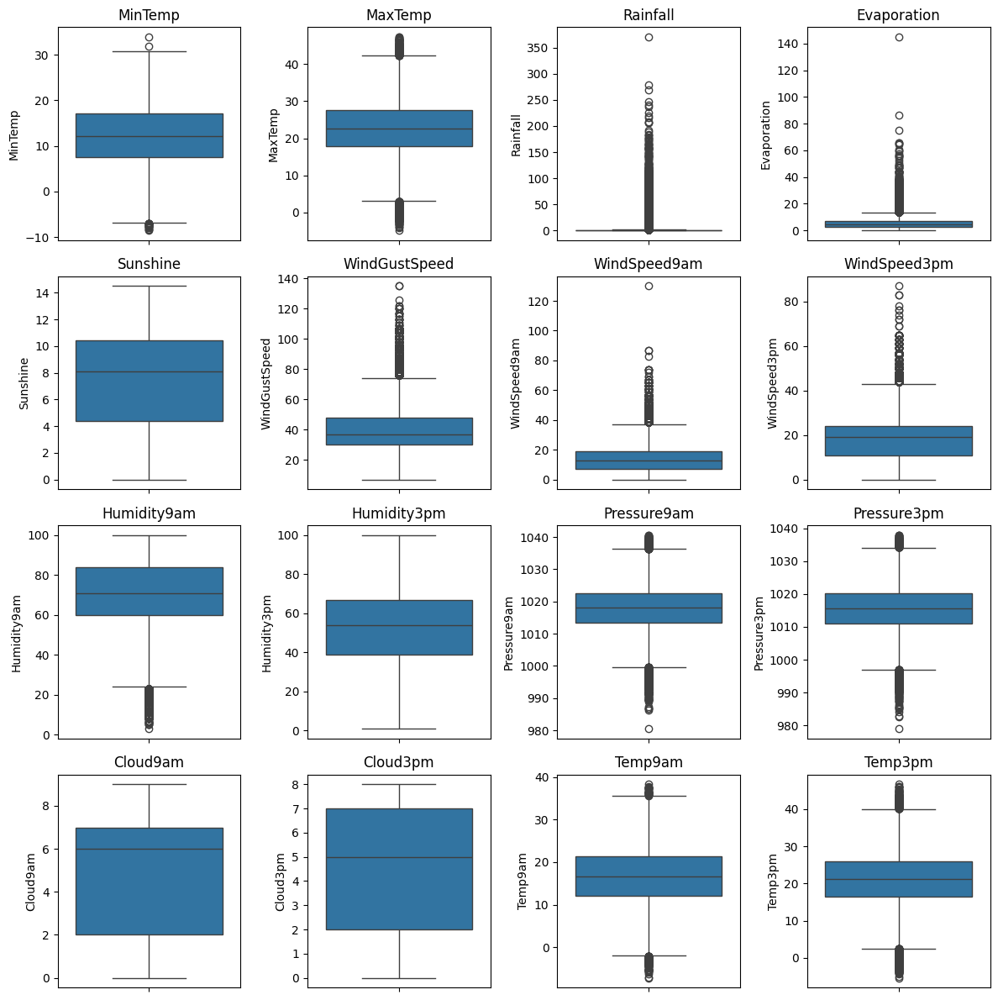

In [12]:
fig, ax = plt.subplots(4, 4, figsize=(12, 12))

for ax, col in zip(ax.flatten(), cont):
    sns.boxplot(y=df[col], ax=ax)
    ax.set_title(col)

fig.tight_layout()
fig.show()

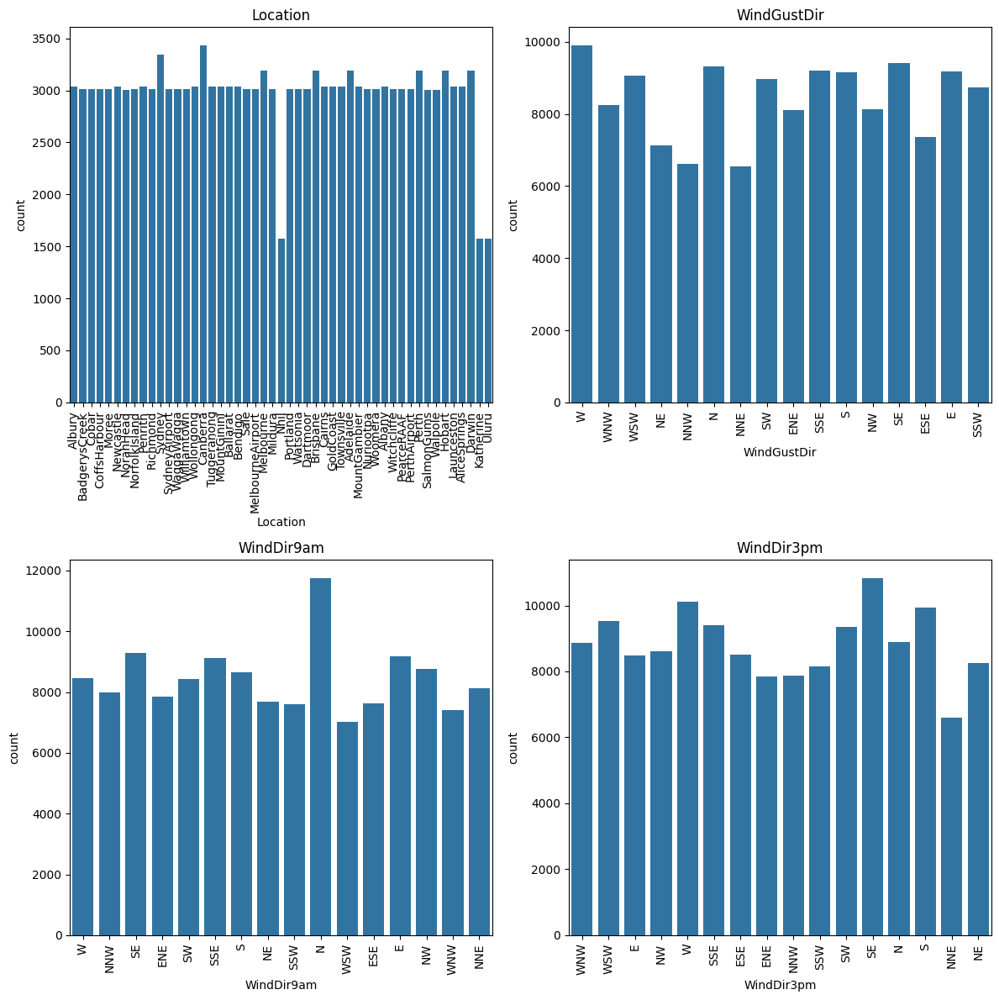

In [19]:
fig, ax = plt.subplots(2, 2, figsize=(12, 12))

for ax, col in zip(ax.flatten(), categorical):
    sns.countplot(x=df[col], ax=ax)
    ax.set_title(col)
    ax.tick_params(axis='x', labelrotation = 90)

fig.tight_layout()
fig.show()

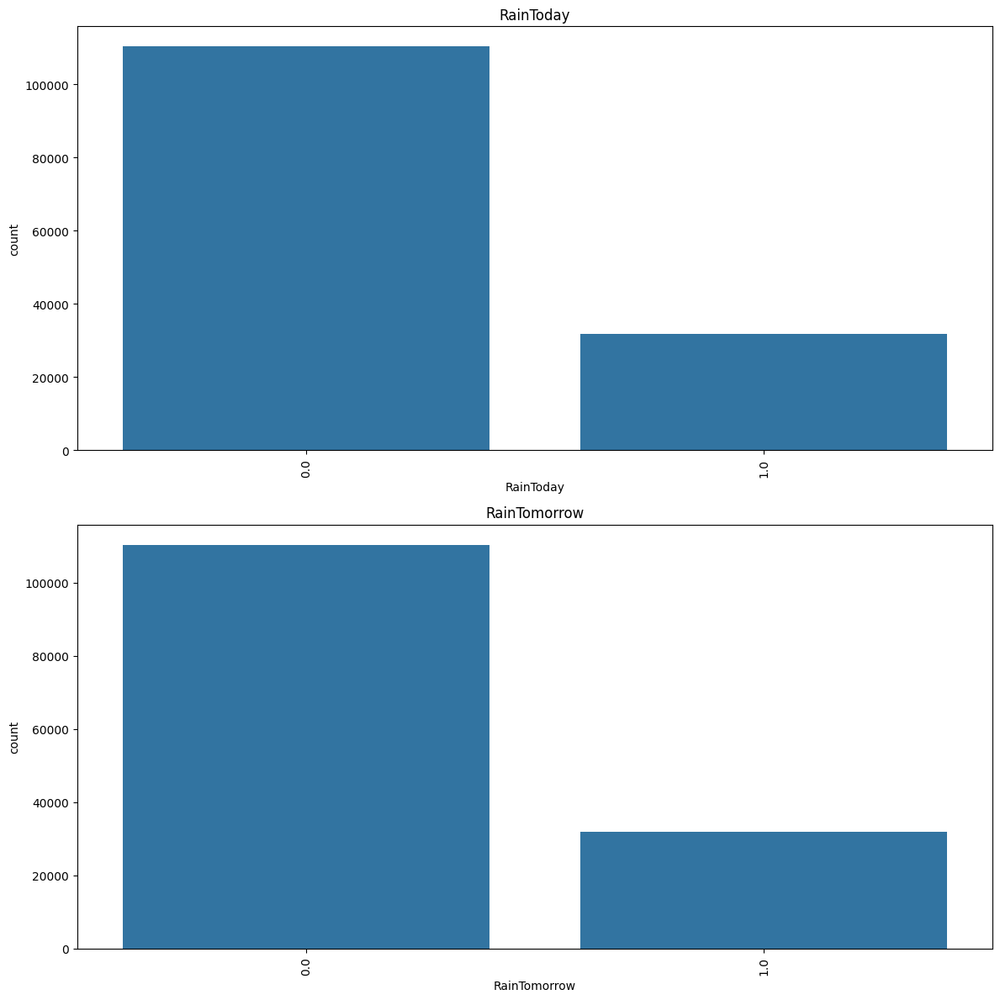

In [20]:
fig, ax = plt.subplots(2, figsize=(12, 12))

for ax, col in zip(ax.flatten(), target):
    sns.countplot(x=df[col], ax=ax)
    ax.set_title(col)
    ax.tick_params(axis='x', labelrotation = 90)

fig.tight_layout()
fig.show()

In [11]:
params = cont + target

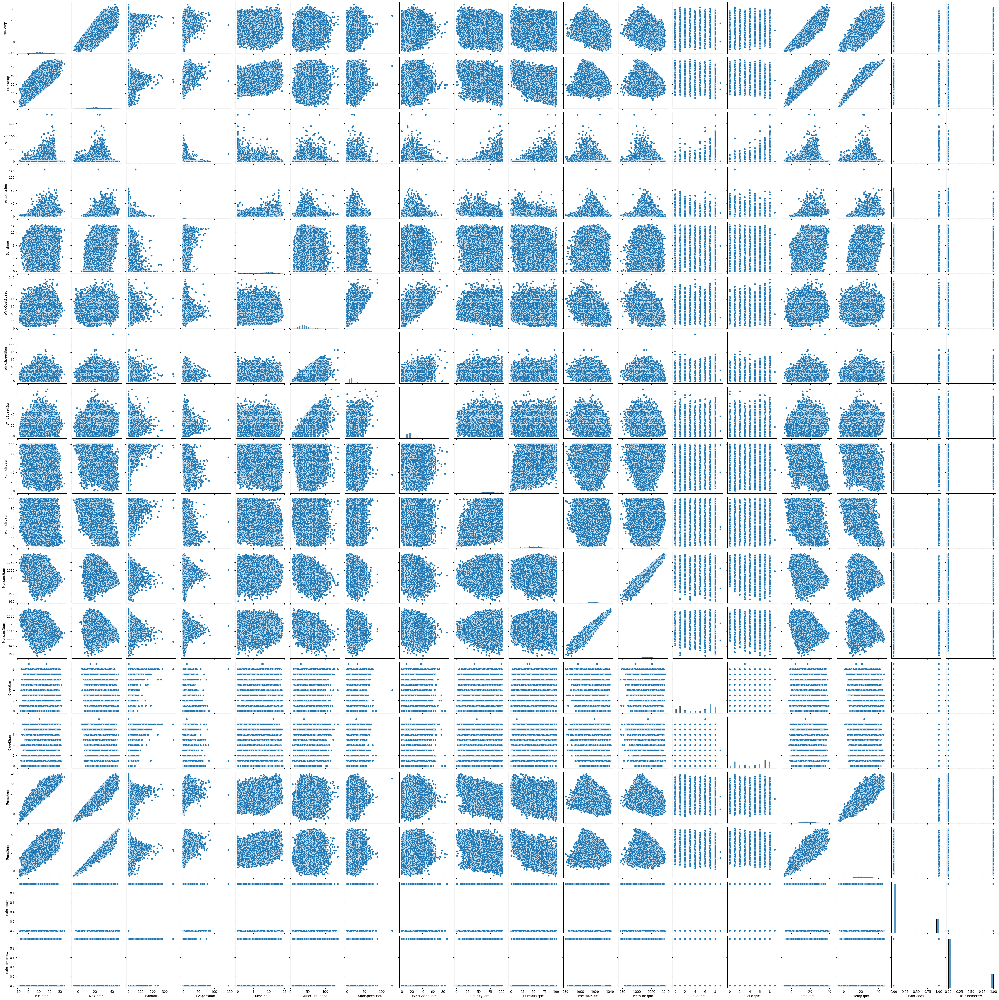

In [ ]:

sns.pairplot(df[params])

### Missing Values

Computing mean_agg-aggregate-mean_chunk-sub-sum-sum-aggregate-truediv-61c0eb090a74ae88da2e0b017bfa7efb:  38%|███▊      | 89/236 [00:00<00:00, 438.90it/s]/usr/local/lib/python3.10/dist-packages/dask/core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))



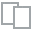
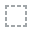
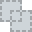
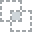
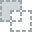
...
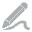
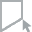
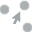
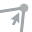
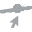

In [12]:
plot_missing(df)

Dealing with missing data points: <br>
1.   Min and Max Temperature: We will be removing any rows missing one or the other value, as it would be hard to impute or otherwise guess the missing temperature reading.
2.   Rainfall, Evaporation, Sunshine, : Any missing data can be assumed as 0
3.   WindGustDir/WindGustSpeed, WindDir9am/WindSpeed9am, WindDir3pm/WindSpeed3pm: These parameters are pairs of a categorical parameter indicating wind direction, and a continuous parameter indicating wind speed. It is possible for there to be no wind, so NA is a valid reading. In the case that there is a mismatch in any pair, that is if there is a direction reading but no speed reading, or vice versa, that row will be removed. Missing speed readings with no wind direction will then be replaced with 0.
4.   Humidity9am, Humidity3am: It is practically impossible to reach zero humidity, so the lowest value recorded will be used to replace the missing values.
5.   Pressure9am, Pressure3pm: Missing values will be replaced with standard atmospheric pressure in hpa (1013.25, according to https://www.noaa.gov/jetstream/atmosphere/air-pressure).
6.   Cloud9am, Cloud3pm: Missing values will be replaced with 0.
7.   Temp9am, Temp3am: Rows with missing values will be dropped.
8.   RainToday, RainTomorrow: Since these are the target values, if there is no prediction then these rows will not be considered.

In [13]:
# Start with removing rows
df_clean = df.copy()
df_clean.dropna(subset=['RainToday', 'RainTomorrow'], inplace=True)

df_clean.dropna(subset=['MinTemp', 'MaxTemp'], inplace=True)

df_clean.dropna(subset=['Temp9am', 'Temp3pm'], inplace=True)

mask1 = ~(df['WindGustDir'].isna() ^ df['WindGustSpeed'].isna())
mask2 = ~(df['WindDir9am'].isna() ^ df['WindSpeed9am'].isna())
mask3 = ~(df['WindDir3pm'].isna() ^ df['WindSpeed3pm'].isna())
df_clean = df_clean[mask1 & mask2 & mask3]
df_clean['WindGustDir'].fillna('NA', inplace=True)
df_clean['WindDir9am'].fillna('NA', inplace=True)
df_clean['WindDir3pm'].fillna('NA', inplace=True)
df_clean['WindGustSpeed'].fillna(0, inplace=True)
df_clean['WindSpeed9am'].fillna(0, inplace=True)
df_clean['WindSpeed3pm'].fillna(0, inplace=True)

df_clean['Rainfall'].fillna(0, inplace=True)
df_clean['Evaporation'].fillna(0, inplace=True)
df_clean['Sunshine'].fillna(0, inplace=True)

df_clean['Humidity9am'].fillna(df_clean['Humidity9am'].min(), inplace=True)
df_clean['Humidity3pm'].fillna(df_clean['Humidity3pm'].min(), inplace=True)

df_clean['Pressure9am'].fillna(1013.25, inplace=True)
df_clean['Pressure3pm'].fillna(1013.25, inplace=True)

df_clean['Cloud9am'].fillna(0, inplace=True)
df_clean['Cloud3pm'].fillna(0, inplace=True)

<ipython-input-13-10aed1b28e57>:12: UserWarning: Boolean Series key will be reindexed to match DataFrame index.
  df_clean = df_clean[mask1 & mask2 & mask3]
<ipython-input-13-10aed1b28e57>:13: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_clean['WindGustDir'].fillna('NA', inplace=True)
<ipython-input-13-10aed1b28e57>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  df_clean['WindDir9am'].fillna('NA', inplace=True)
<ipython-input-13-10aed1b28e57>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/

In [14]:
#df_clean.to_csv("/content/drive/MyDrive/Colab Notebooks/Datasets/AAI-510/Project/weatherAUS_clean.csv", index=False)
df_clean.to_csv("AUS_Weather.csv", index=False)

In [15]:
shap = df_clean.shape
print("Shape of the dataframe (row, col):",shap,"\r\n")

df_clean

Shape of the dataframe (row, col): (128668, 23) 



,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,12/1/2008,Albury,13.4,22.9,0.6,0.0,0.0,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,0.0,16.9,21.8,0.0,0.0
1,12/2/2008,Albury,7.4,25.1,0.0,0.0,0.0,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,0.0,0.0,17.2,24.3,0.0,0.0
2,12/3/2008,Albury,12.9,25.7,0.0,0.0,0.0,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,0.0,2.0,21.0,23.2,0.0,0.0
3,12/4/2008,Albury,9.2,28.0,0.0,0.0,0.0,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,0.0,0.0,18.1,26.5,0.0,0.0
4,12/5/2008,Albury,17.5,32.3,1.0,0.0,0.0,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145454,6/20/2017,Uluru,3.5,21.8,0.0,0.0,0.0,E,31.0,ESE,...,59.0,27.0,1024.7,1021.2,0.0,0.0,9.4,20.9,0.0,0.0
145455,6/21/2017,Uluru,2.8,23.4,0.0,0.0,0.0,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,0.0,0.0,10.1,22.4,0.0,0.0
145456,6/22/2017,Uluru,3.6,25.3,0.0,0.0,0.0,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,0.0,0.0,10.9,24.5,0.0,0.0
145457,6/23/2017,Uluru,5.4,26.9,0.0,0.0,0.0,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,0.0,0.0,12.5,26.1,0.0,0.0


Computing concatenate-4289e97b317c3490753b5e072c2b5937:  60%|█████▉    | 147/246 [00:00<00:00, 651.49it/s]/usr/local/lib/python3.10/dist-packages/dask/core.py:121: RuntimeWarning: invalid value encountered in divide
  return func(*(_execute_task(a, cache) for a in args))



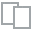
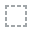
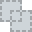
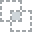
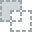
...
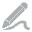
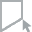
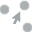
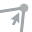
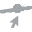

In [16]:
plot_missing(df_clean)

In [17]:
print(df_clean["Location"].value_counts())

Sydney              3289
Darwin              3158
Hobart              3122
Canberra            3065
Perth               3052
Brisbane            3030
SydneyAirport       2993
PerthAirport        2970
MelbourneAirport    2959
Cobar               2957
Woomera             2944
MountGambier        2936
Cairns              2917
Ballarat            2910
NorfolkIsland       2910
Mildura             2908
Townsville          2905
SalmonGums          2900
Sale                2899
GoldCoast           2895
CoffsHarbour        2869
Portland            2851
Nuriootpa           2828
Wollongong          2826
WaggaWagga          2826
NorahHead           2794
AliceSprings        2792
Adelaide            2763
Watsonia            2761
Bendigo             2755
Moree               2711
Witchcliffe         2658
PearceRAAF          2539
Launceston          2522
Walpole             2511
BadgerysCreek       2467
Albury              2445
Dartmoor            2418
MountGinini         2388
Penrith             2368


In [18]:
print(df_clean.shape[0] / df.shape[0])

0.8845593290251615


Culled approximately 11.6% of original dataset.

### Visualization of clean dataset.

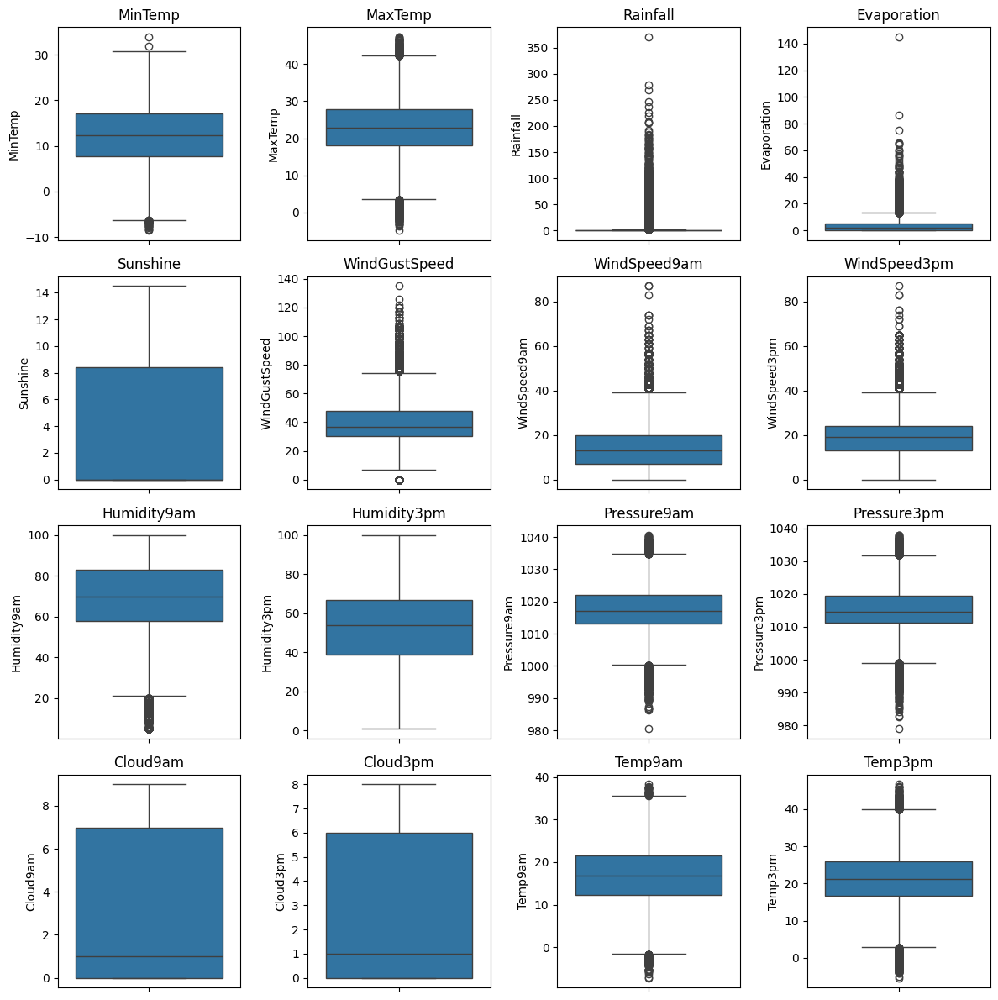

In [20]:
fig, ax = plt.subplots(4, 4, figsize=(12, 12))

for ax, col in zip(ax.flatten(), cont):
    sns.boxplot(y=df_clean[col], ax=ax)
    ax.set_title(col)

fig.tight_layout()
fig.show()

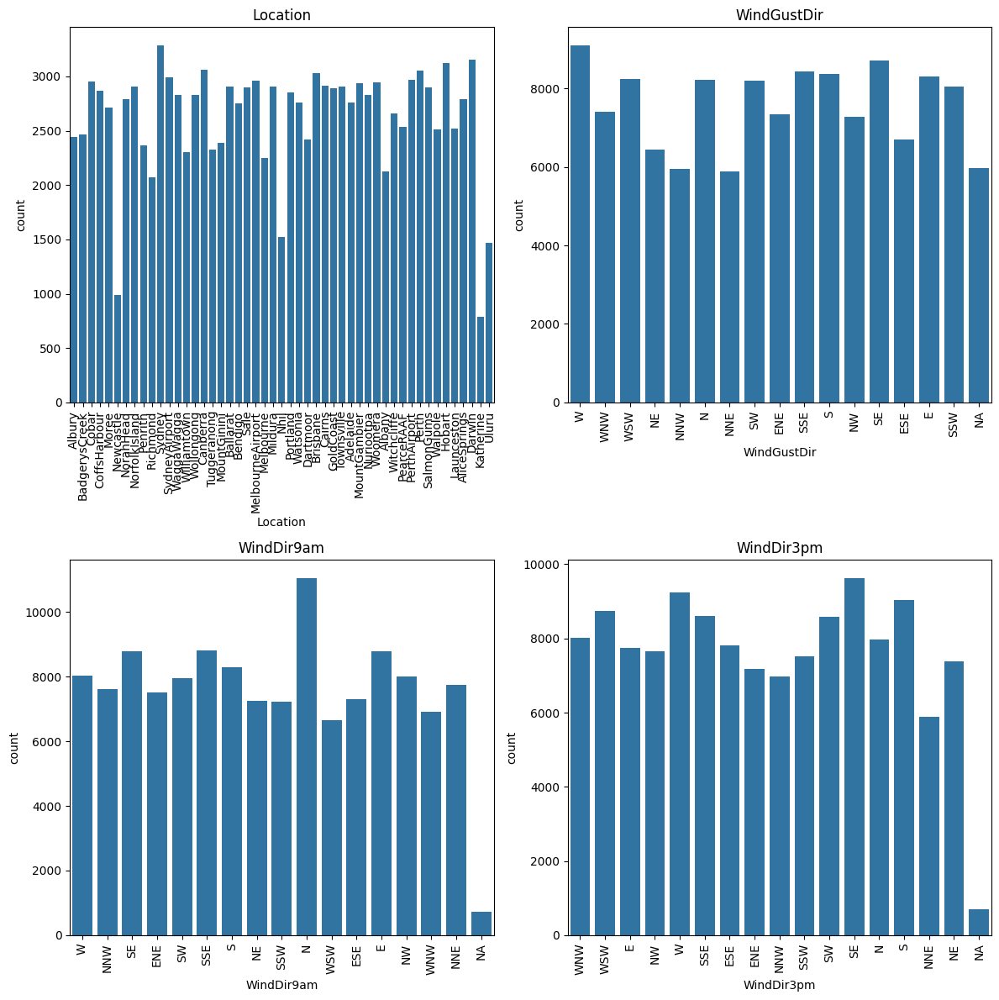

In [29]:
fig, ax = plt.subplots(2, 2, figsize=(12, 12))

for ax, col in zip(ax.flatten(), categorical):
    sns.countplot(x=df_clean[col], ax=ax)
    ax.set_title(col)
    ax.tick_params(axis='x', labelrotation = 90)

fig.tight_layout()
fig.show()

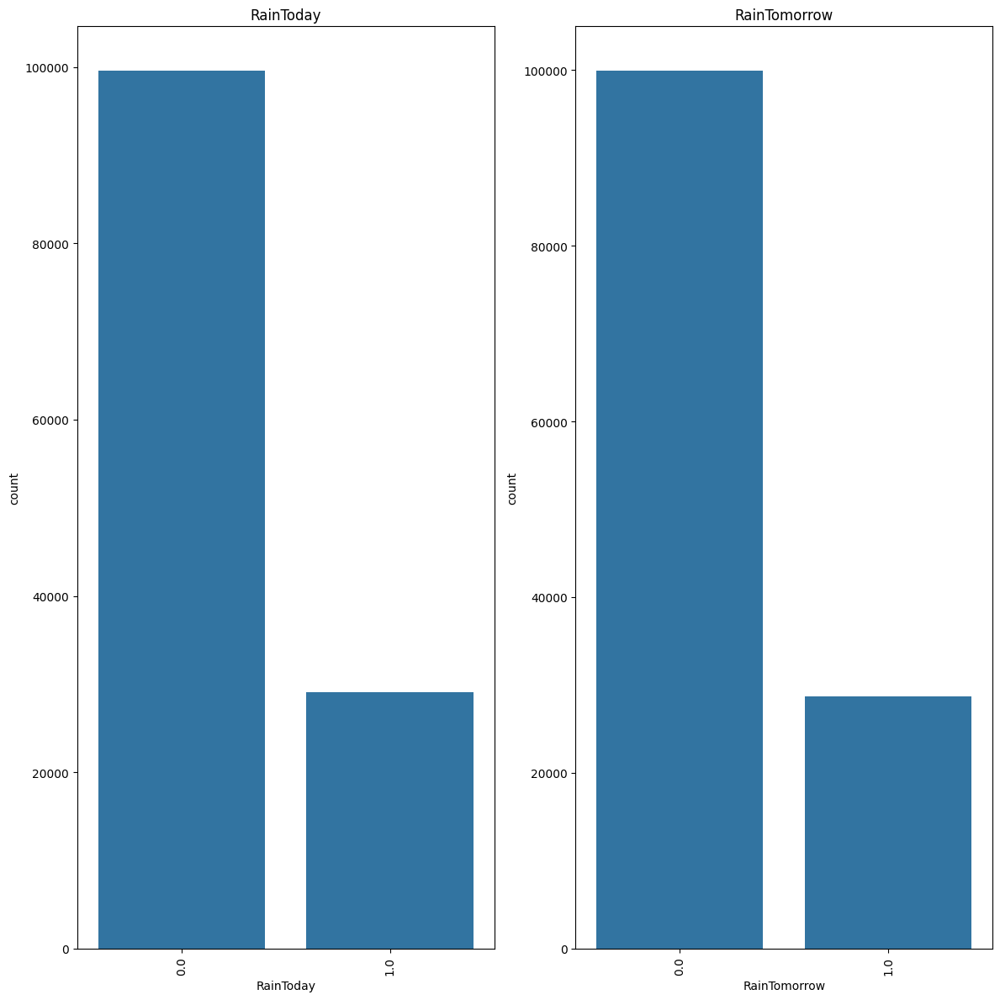

In [30]:
fig, ax = plt.subplots(1, 2, figsize=(12, 12))

for ax, col in zip(ax.flatten(), target):
    sns.countplot(x=df_clean[col], ax=ax)
    ax.set_title(col)
    ax.tick_params(axis='x', labelrotation = 90)

fig.tight_layout()
fig.show()

In [31]:
params = cont + target

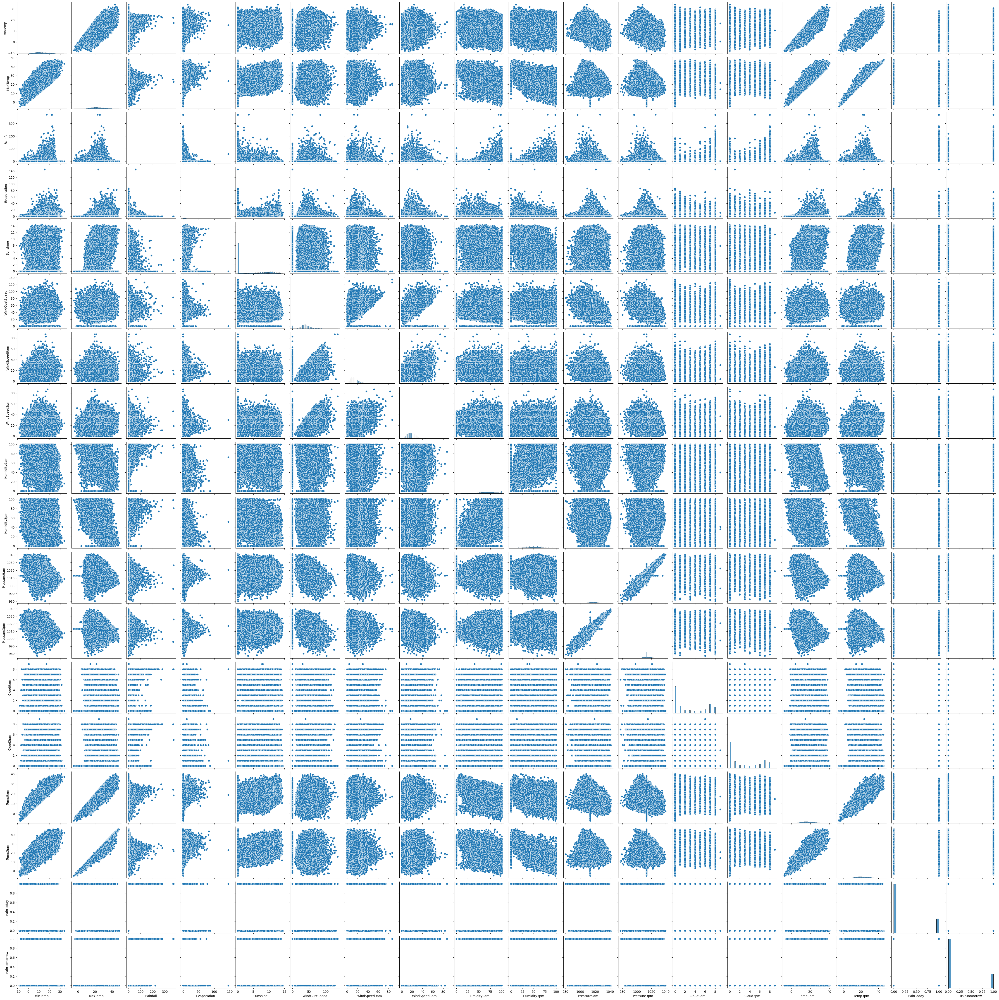

In [ ]:

sns.pairplot(df_clean[params])

Heatmap of correlations with cleaned dataset:

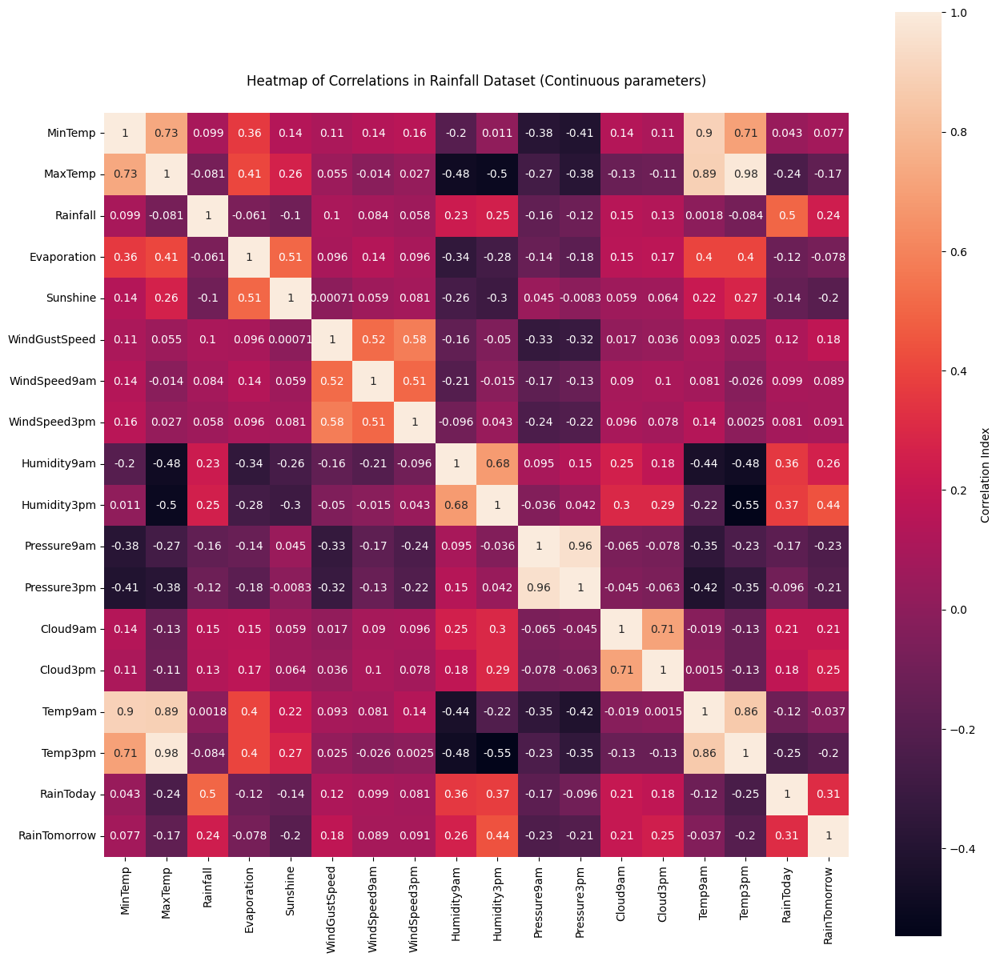

In [32]:
heatmap = df_clean[params]
correlations = heatmap.corr()
plt.figure(figsize = (15, 15))
ax = sns.heatmap(correlations[params],
                 annot = True, square = True,
                 cbar_kws={'label': 'Correlation Index'})
ax.set_title('Heatmap of Correlations in Rainfall Dataset (Continuous parameters)')
ax.set_ylim(len(correlations), -0.5)
plt.show()

References:<br>
https://stackoverflow.com/questions/63723514/userwarning-fixedformatter-should-only-be-used-together-with-fixedlocator <br><br>
https://www.noaa.gov/jetstream/atmosphere/air-pressure<br><br>


In [ ]:
#project running
shap = df_clean.shape
print("Shape of the dataframe (row, col):",shap,"\r\n")

Shape of the dataframe (row, col): (128668, 23) 



In [ ]:
# Show the dataframe
df_clean

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,12/1/2008,Albury,13.4,22.9,0.6,0.0,0.0,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,0.0,16.9,21.8,0.0,0.0
1,12/2/2008,Albury,7.4,25.1,0.0,0.0,0.0,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,0.0,0.0,17.2,24.3,0.0,0.0
2,12/3/2008,Albury,12.9,25.7,0.0,0.0,0.0,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,0.0,2.0,21.0,23.2,0.0,0.0
3,12/4/2008,Albury,9.2,28.0,0.0,0.0,0.0,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,0.0,0.0,18.1,26.5,0.0,0.0
4,12/5/2008,Albury,17.5,32.3,1.0,0.0,0.0,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145454,6/20/2017,Uluru,3.5,21.8,0.0,0.0,0.0,E,31.0,ESE,...,59.0,27.0,1024.7,1021.2,0.0,0.0,9.4,20.9,0.0,0.0
145455,6/21/2017,Uluru,2.8,23.4,0.0,0.0,0.0,E,31.0,SE,...,51.0,24.0,1024.6,1020.3,0.0,0.0,10.1,22.4,0.0,0.0
145456,6/22/2017,Uluru,3.6,25.3,0.0,0.0,0.0,NNW,22.0,SE,...,56.0,21.0,1023.5,1019.1,0.0,0.0,10.9,24.5,0.0,0.0
145457,6/23/2017,Uluru,5.4,26.9,0.0,0.0,0.0,N,37.0,SE,...,53.0,24.0,1021.0,1016.8,0.0,0.0,12.5,26.1,0.0,0.0


In [ ]:
#display the first 5 rows in dataset:
df_clean.head(5)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,12/1/2008,Albury,13.4,22.9,0.6,0.0,0.0,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,0.0,16.9,21.8,0.0,0.0
1,12/2/2008,Albury,7.4,25.1,0.0,0.0,0.0,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,0.0,0.0,17.2,24.3,0.0,0.0
2,12/3/2008,Albury,12.9,25.7,0.0,0.0,0.0,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,0.0,2.0,21.0,23.2,0.0,0.0
3,12/4/2008,Albury,9.2,28.0,0.0,0.0,0.0,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,0.0,0.0,18.1,26.5,0.0,0.0
4,12/5/2008,Albury,17.5,32.3,1.0,0.0,0.0,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0.0,0.0


In [ ]:
#shows the data type of each column, number of columns, memory usage, and the number of records in the dataset:
df_clean.info()

<class 'pandas.core.frame.DataFrame'>
Index: 128668 entries, 0 to 145458
Data columns (total 23 columns):
 #   Column         Non-Null Count   Dtype  
---  ------         --------------   -----  
 0   Date           128668 non-null  object 
 1   Location       128668 non-null  object 
 2   MinTemp        128668 non-null  float64
 3   MaxTemp        128668 non-null  float64
 4   Rainfall       128668 non-null  float64
 5   Evaporation    128668 non-null  float64
 6   Sunshine       128668 non-null  float64
 7   WindGustDir    128668 non-null  object 
 8   WindGustSpeed  128668 non-null  float64
 9   WindDir9am     128668 non-null  object 
 10  WindDir3pm     128668 non-null  object 
 11  WindSpeed9am   128668 non-null  float64
 12  WindSpeed3pm   128668 non-null  float64
 13  Humidity9am    128668 non-null  float64
 14  Humidity3pm    128668 non-null  float64
 15  Pressure9am    128668 non-null  float64
 16  Pressure3pm    128668 non-null  float64
 17  Cloud9am       128668 non-null  fl

In [ ]:
#display the number of records and columns:
df_clean.shape

(128668, 23)

In [ ]:
#summarize the dataset’s statistical properties, such as count, mean, min, and max:
df_clean.describe()

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
count,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000,128668.000000
mean,12.412526,23.382816,2.373184,3.294501,4.226889,38.798023,14.865266,19.073080,67.425700,50.841289,1017.104703,1014.933797,2.810139,2.805764,17.209256,21.850926,0.225627,0.222907
std,6.291213,7.085184,8.516391,4.236013,4.737665,15.628630,8.419006,8.738816,19.498807,21.178786,6.846609,6.699916,3.129008,3.056518,6.403613,6.952700,0.417996,0.416198
min,-8.500000,-4.800000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,980.500000,977.100000,0.000000,0.000000,-7.200000,-5.400000,0.000000,0.000000
25%,7.900000,18.100000,0.000000,0.000000,0.000000,30.000000,9.000000,13.000000,56.000000,36.000000,1013.250000,1010.800000,0.000000,0.000000,12.500000,16.800000,0.000000,0.000000
50%,12.200000,22.800000,0.000000,2.000000,1.400000,39.000000,13.000000,19.000000,69.000000,51.000000,1016.700000,1014.300000,1.000000,1.000000,16.900000,21.300000,0.000000,0.000000
75%,17.000000,28.400000,0.800000,5.600000,9.000000,48.000000,20.000000,24.000000,82.000000,65.000000,1021.700000,1019.300000,6.000000,6.000000,21.700000,26.600000,0.000000,0.000000
max,33.900000,48.100000,371.000000,145.000000,14.500000,135.000000,87.000000,87.000000,100.000000,100.000000,1041.000000,1039.600000,9.000000,9.000000,40.200000,46.700000,1.000000,1.000000


In [ ]:
# Get unique values in 'Location'
unique_values_column1 = df_clean['Location'].unique()
print("Unique values in 'Location':", unique_values_column1)

Unique values in 'Location': ['Albury' 'BadgerysCreek' 'Cobar' 'CoffsHarbour' 'Moree' 'Newcastle'
 'NorahHead' 'NorfolkIsland' 'Penrith' 'Richmond' 'Sydney' 'SydneyAirport'
 'WaggaWagga' 'Williamtown' 'Wollongong' 'Canberra' 'Tuggeranong'
 'MountGinini' 'Ballarat' 'Bendigo' 'Sale' 'MelbourneAirport' 'Melbourne'
 'Mildura' 'Nhil' 'Portland' 'Watsonia' 'Dartmoor' 'Brisbane' 'Cairns'
 'GoldCoast' 'Townsville' 'Adelaide' 'MountGambier' 'Nuriootpa' 'Woomera'
 'Albany' 'Witchcliffe' 'PearceRAAF' 'PerthAirport' 'Perth' 'SalmonGums'
 'Walpole' 'Hobart' 'Launceston' 'AliceSprings' 'Darwin' 'Katherine'
 'Uluru']


In [ ]:
# Get unique values in 'WindGustDir'
unique_values_in_column = df_clean['WindGustDir'].unique()
print("Unique values in 'WindGustDir':", unique_values_in_column)

Unique values in 'WindGustDir': ['W' 'WNW' 'WSW' 'NE' 'NNW' 'N' 'NNE' 'SW' 'ENE' 'SSE' 'S' 'NW' 'SE' 'ESE'
 'E' 'SSW' 'NA']


In [ ]:
# Get unique values in 'WindDir9am'
unique_values_in_column = df_clean['WindDir9am'].unique()
print("Unique values in 'WindDir9am':", unique_values_in_column)

Unique values in 'WindDir9am': ['W' 'NNW' 'SE' 'ENE' 'SW' 'SSE' 'S' 'NE' 'SSW' 'N' 'WSW' 'ESE' 'E' 'NW'
 'WNW' 'NNE' 'NA']


In [ ]:
# Get unique values in 'WindDir3pm'
unique_values_in_column = df_clean['WindDir3pm'].unique()
print("Unique values in 'WindDir3pm':", unique_values_in_column)

Unique values in 'WindDir3pm': ['WNW' 'WSW' 'E' 'NW' 'W' 'SSE' 'ESE' 'ENE' 'NNW' 'SSW' 'SW' 'SE' 'N' 'S'
 'NNE' 'NE' 'NA']


In [ ]:
# Get unique values in 'RainToday'
unique_values_in_column = df_clean['RainToday'].unique()
print("Unique values in 'RainToday':", unique_values_in_column)

Unique values in 'RainToday': [0. 1.]


In [ ]:
# Get unique values in 'RainTomorrow'
unique_values_in_column = df_clean['RainTomorrow'].unique()
print("Unique values in 'RainTomorrow':", unique_values_in_column)

Unique values in 'RainTomorrow': [0. 1.]


In [ ]:
df_clean.fillna(0, inplace=True)

In [ ]:
df_clean["WindGustDir"] = df_clean['WindGustDir'].replace({'N': 1,
'NNE': 2,
'NE': 3,
'ENE': 4,
'E': 5,
'SE': 6,
'ESE': 7,
'SSE': 8,
'S': 9,
'SSW': 10,
'SW': 11,
'WSW': 12,
'W': 13,
'WNW': 14,
'NW': 15,
'NNW': 16,
'NA': 17}).astype(int)

In [ ]:
df_clean["RainToday"] = df_clean['RainToday'].replace({'0.': 0}).astype(int)

In [ ]:
df_clean["RainTomorrow"] = df_clean['RainTomorrow'].replace({'No': 0, 'Yes': 1, '0': 2}).astype(int)

In [ ]:
df_clean["WindGustDir"] = df_clean['WindGustDir'].replace({'N': 1,
'NNE': 2,
'NE': 3,
'ENE': 4,
'E': 5,
'SE': 6,
'ESE': 7,
'SSE': 8,
'S': 9,
'SSW': 10,
'SW': 11,
'WSW': 12,
'W': 13,
'WNW': 14,
'NW': 15,
'NNW': 16,
'NA':17}).astype(int)

In [ ]:
df_clean["WindDir9am"] = df_clean['WindDir9am'].replace({'N': 1,
'NNE': 2,
'NE': 3,
'ENE': 4,
'E': 5,
'SE': 6,
'ESE': 7,
'SSE': 8,
'S': 9,
'SSW': 10,
'SW': 11,
'WSW': 12,
'W': 13,
'WNW': 14,
'NW': 15,
'NNW': 16,
'NA':17}).astype(int)

In [ ]:
df_clean["WindDir3pm"] = df_clean['WindDir3pm'].replace({'N': 1,
'NNE': 2,
'NE': 3,
'ENE': 4,
'E': 5,
'SE': 6,
'ESE': 7,
'SSE': 8,
'S': 9,
'SSW': 10,
'SW': 11,
'WSW': 12,
'W': 13,
'WNW': 14,
'NW': 15,
'NNW': 16,
'NA':17}).astype(int)

In [ ]:
df_clean["Location"] = df_clean['Location'].replace({'Adelaide': 1,
'Albany': 2,
'Albury': 3,
'AliceSprings': 4,
'BadgerysCreek': 5,
'Ballarat': 6,
'Bendigo': 7,
'Brisbane': 8,
'Cairns': 9,
'Canberra': 10,
'Cobar': 11,
'CoffsHarbour': 12,
'Dartmoor': 13,
'Darwin': 14,
'GoldCoast': 15,
'Hobart': 16,
'Katherine': 17,
'Launceston': 18,
'Melbourne': 19,
'MelbourneAirport': 20,
'Mildura': 21,
'Moree': 22,
'MountGambier': 23,
'MountGinini': 24,
'Newcastle': 25,
'Nhil': 26,
'NorahHead': 27,
'NorfolkIsland': 28,
'Nuriootpa': 29,
'PearceRAAF': 30,
'Penrith': 31,
'Perth': 32,
'PerthAirport': 33,
'Portland': 34,
'Richmond': 35,
'Sale': 36,
'SalmonGums': 37,
'Sydney': 38,
'SydneyAirport': 39,
'Townsville': 40,
'Tuggeranong': 41,
'Uluru': 42,
'WaggaWagga': 43,
'Walpole': 44,
'Watsonia': 45,
'Williamtown': 46,
'Witchcliffe': 47,
'Wollongong': 48,
'Woomera': 49}).astype(int)

In [ ]:
# Remove date column
del df_clean['Date']

In [ ]:
#display the first 5 rows in dataset:
print(df_clean.iloc[:5])

        Date  Location  MinTemp  MaxTemp  Rainfall  Evaporation  Sunshine   
0  12/1/2008         3     13.4     22.9       0.6          0.0       0.0  \
1  12/2/2008         3      7.4     25.1       0.0          0.0       0.0   
2  12/3/2008         3     12.9     25.7       0.0          0.0       0.0   
3  12/4/2008         3      9.2     28.0       0.0          0.0       0.0   
4  12/5/2008         3     17.5     32.3       1.0          0.0       0.0   

   WindGustDir  WindGustSpeed  WindDir9am  ...  Humidity9am  Humidity3pm   
0           13           44.0          13  ...         71.0         22.0  \
1           14           44.0          16  ...         44.0         25.0   
2           12           46.0          13  ...         38.0         30.0   
3            3           24.0           6  ...         45.0         16.0   
4           13           41.0           4  ...         82.0         33.0   

   Pressure9am  Pressure3pm  Cloud9am  Cloud3pm  Temp9am  Temp3pm  RainToday   


In [ ]:
#display the correlation between different variables in dataset:
df_clean.corr()

,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,WindDir3pm,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
Location,1.000000,-0.010229,-0.024626,-0.005836,0.002046,0.007924,-0.028506,0.116079,0.008913,-0.019508,...,-0.003544,0.006948,0.030091,0.047351,-0.022766,-0.031204,-0.020654,-0.027238,-0.007470,-0.007092
MinTemp,-0.010229,1.000000,0.731376,0.098722,0.364750,0.137661,-0.161613,0.108889,-0.105088,-0.184901,...,-0.200974,0.011311,-0.378646,-0.408977,0.138063,0.110435,0.896692,0.707163,0.043447,0.077185
MaxTemp,-0.024626,0.731376,1.000000,-0.080895,0.407077,0.262792,-0.192927,0.055100,-0.243980,-0.150882,...,-0.484601,-0.499154,-0.273479,-0.378343,-0.130088,-0.113818,0.888858,0.984322,-0.240653,-0.166551
Rainfall,-0.005836,0.098722,-0.080895,1.000000,-0.060994,-0.104195,0.034570,0.102450,0.067444,0.034278,...,0.227987,0.253821,-0.155994,-0.117715,0.148975,0.130414,0.001783,-0.084249,0.500026,0.238814
Evaporation,0.002046,0.364750,0.407077,-0.060994,1.000000,0.506092,-0.082979,0.095792,-0.101484,-0.061796,...,-0.341919,-0.275114,-0.136225,-0.179246,0.154795,0.171003,0.399728,0.401173,-0.122650,-0.078148
Sunshine,0.007924,0.137661,0.262792,-0.104195,0.506092,1.000000,-0.056031,0.000709,-0.076645,-0.040244,...,-0.262027,-0.296200,0.045054,-0.008261,0.059254,0.064481,0.216567,0.274740,-0.144331,-0.195306
WindGustDir,-0.028506,-0.161613,-0.192927,0.034570,-0.082979,-0.056031,1.000000,-0.091331,0.348831,0.526542,...,0.058983,0.039769,-0.158950,-0.090247,0.027583,0.033737,-0.188669,-0.203687,0.108628,0.062040
WindGustSpeed,0.116079,0.108889,0.055100,0.102450,0.095792,0.000709,-0.091331,1.000000,-0.011996,0.092342,...,-0.155962,-0.049539,-0.334589,-0.316354,0.016787,0.035626,0.093244,0.025345,0.115844,0.180834
WindDir9am,0.008913,-0.105088,-0.243980,0.067444,-0.101484,-0.076645,0.348831,-0.011996,1.000000,0.269355,...,0.130263,0.152377,-0.070832,0.008206,0.016571,0.004586,-0.175051,-0.250307,0.146113,0.035697
WindDir3pm,-0.019508,-0.184901,-0.150882,0.034278,-0.061796,-0.040244,0.526542,0.092342,0.269355,1.000000,...,0.022408,-0.048970,-0.173469,-0.107803,-0.007587,0.005558,-0.185183,-0.155759,0.098826,0.045936


In [ ]:
from sklearn.tree import DecisionTreeClassifier
from sklearn.model_selection import train_test_split
from sklearn import tree

In [ ]:
X=pd.DataFrame(df_clean)

In [ ]:
print(X.head())

   Location  MinTemp  MaxTemp  Rainfall  Evaporation  Sunshine  WindGustDir   
0         3     13.4     22.9       0.6          0.0       0.0           13  \
1         3      7.4     25.1       0.0          0.0       0.0           14   
2         3     12.9     25.7       0.0          0.0       0.0           12   
3         3      9.2     28.0       0.0          0.0       0.0            3   
4         3     17.5     32.3       1.0          0.0       0.0           13   

   WindGustSpeed  WindDir9am  WindDir3pm  ...  Humidity9am  Humidity3pm   
0           44.0          13          14  ...         71.0         22.0  \
1           44.0          16          12  ...         44.0         25.0   
2           46.0          13          12  ...         38.0         30.0   
3           24.0           6           5  ...         45.0         16.0   
4           41.0           4          15  ...         82.0         33.0   

   Pressure9am  Pressure3pm  Cloud9am  Cloud3pm  Temp9am  Temp3pm  RainTod

In [ ]:
print(df_clean.columns)

Index(['Location', 'MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine',
       'WindGustDir', 'WindGustSpeed', 'WindDir9am', 'WindDir3pm',
       'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
       'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm', 'Temp9am',
       'Temp3pm', 'RainToday', 'RainTomorrow'],
      dtype='object')


In [ ]:
# Select features
features = ['Location',
 'MinTemp',
 'MaxTemp',
 'Rainfall',
 'Evaporation',
 'Sunshine',
 'WindGustSpeed',
 'WindSpeed9am',
 'WindSpeed3pm',
 'Humidity9am',
 'Humidity3pm',
 'Pressure9am',
 'Pressure3pm',
 'Cloud9am',
 'Cloud3pm',
 'Temp9am',
 'Temp3pm',
 'RainToday']
X_selected = X[features]

In [ ]:
# Select Target
y = X['RainTomorrow']

In [ ]:
# Split the data into training and test sets
X_train, X_test, y_train, y_test = train_test_split(X_selected, y, test_size=0.3, random_state=42)

In [ ]:
# Initialize the classifier
clf = DecisionTreeClassifier(random_state=42)

# Fit the model
clf.fit(X_train, y_train)

# Predict on the test set
y_pred = clf.predict(X_test)

# Evaluate the model
accuracy = np.mean(y_pred == y_test)
print(f'Accuracy: {accuracy:.2f}')

Accuracy: 0.79


Designating target and features

In [ ]:
df_original = df_clean.copy()

In [ ]:
#@title Designating target and features
y = df_clean.RainTomorrow # Target variable
df_clean = df_clean.drop(columns=['RainTomorrow']) # Features by dropping the target column

In [ ]:
#projectXXXrunning
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=1) # 70% training and 30% test/valid

Decision Tree

Building the Decision Tree

In [ ]:
#@title Building the Decision Tree
clf = tree.DecisionTreeClassifier() # Create Decision Tree classifer object
clf = clf.fit(X_train, y_train) # Train Decision Tree Classifer

Evaluating the Tree model

In [ ]:
#@title Evaluating the Tree model
y_hat = clf.predict(X_train) # Predict the response for train dataset

y_pred = clf.predict(X_test) # Predict the response for test dataset

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, y_pred))

Train Accuracy: 1.0
Test Accuracy: 1.0


Visualizing the Tree

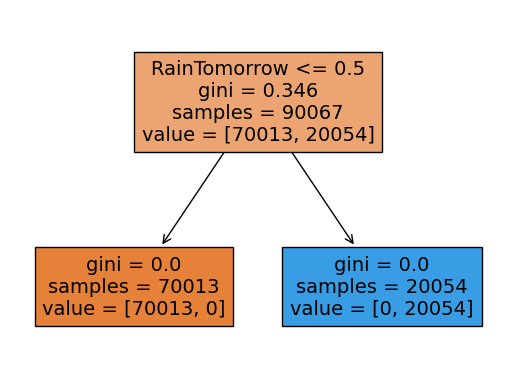

In [ ]:
#@title Visualizing the Tree

f_names=list(X.columns) # Feature names
tree.plot_tree(clf, filled=True, feature_names=f_names) # Plot the tree
plt.show() # Show without the rules in plain text

Train Accuracy: 1.0
Test Accuracy: 1.0


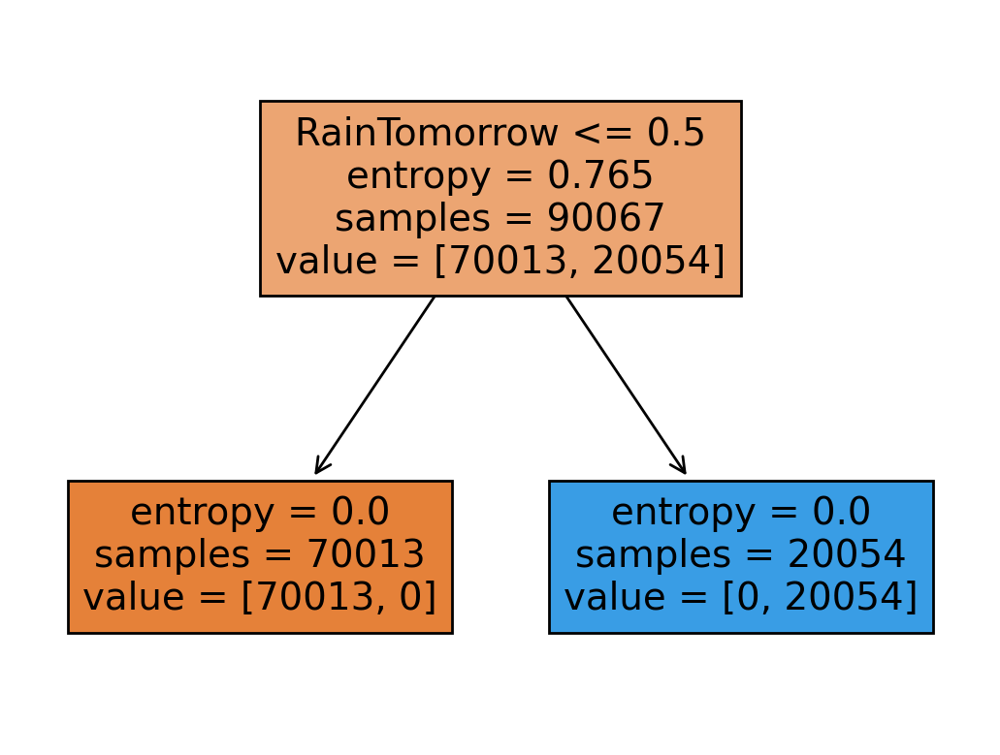

In [ ]:
# Create Decision Tree classifer object by spefifying parameters
# Try using max_depth=3, min_samples_split=100, min_samples_leaf=2, criterion="entropy"
clf = tree.DecisionTreeClassifier(max_depth=3, min_samples_leaf=2, criterion='entropy')

# Train and test the classifier
clf = clf.fit(X_train, y_train) # Train Decision Tree Classifer
y_hat = clf.predict(X_train) # Predict the response for train dataset
y_pred = clf.predict(X_test) # Predict the response for test dataset

# Compute training and test accuracy
print("Train Accuracy:", metrics.accuracy_score(y_train, y_hat))
print("Test Accuracy:", metrics.accuracy_score(y_test, y_pred))

plt.rcParams['figure.dpi'] = 200 # To increase the resolution from 100dpi to 200dpi

# Plot the tree
f_names=list(X.columns) # Feature names
tree.plot_tree(clf, filled=True, feature_names=f_names) # Plot the tree
plt.show() # Show without the rules in plain text

RANDOM FOREST

In [33]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, classification_report, confusion_matrix
from sklearn.preprocessing import OneHotEncoder
from sklearn.impute import SimpleImputer

In [34]:
df_clean.head(5)

,Date,Location,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustDir,WindGustSpeed,WindDir9am,...,Humidity9am,Humidity3pm,Pressure9am,Pressure3pm,Cloud9am,Cloud3pm,Temp9am,Temp3pm,RainToday,RainTomorrow
0,12/1/2008,Albury,13.4,22.9,0.6,0.0,0.0,W,44.0,W,...,71.0,22.0,1007.7,1007.1,8.0,0.0,16.9,21.8,0.0,0.0
1,12/2/2008,Albury,7.4,25.1,0.0,0.0,0.0,WNW,44.0,NNW,...,44.0,25.0,1010.6,1007.8,0.0,0.0,17.2,24.3,0.0,0.0
2,12/3/2008,Albury,12.9,25.7,0.0,0.0,0.0,WSW,46.0,W,...,38.0,30.0,1007.6,1008.7,0.0,2.0,21.0,23.2,0.0,0.0
3,12/4/2008,Albury,9.2,28.0,0.0,0.0,0.0,NE,24.0,SE,...,45.0,16.0,1017.6,1012.8,0.0,0.0,18.1,26.5,0.0,0.0
4,12/5/2008,Albury,17.5,32.3,1.0,0.0,0.0,W,41.0,ENE,...,82.0,33.0,1010.8,1006.0,7.0,8.0,17.8,29.7,0.0,0.0


In [35]:
df_clean['RainTomorrow'] = df_original['RainTomorrow']

In [36]:
df_clean.dropna(subset=['RainTomorrow'], inplace=True)

In [37]:
# Check if 'Date' column exists
if 'Date' in df_clean.columns:
    # Convert dates to datetime format
    df_clean['Date'] = pd.to_datetime(df_clean['Date'])

    # Extract date features
    df_clean['Year'] = df_clean['Date'].dt.year
    df_clean['Month'] = df_clean['Date'].dt.month
    df_clean['Day'] = df_clean['Date'].dt.day

    df_clean.drop(columns=['Date'], inplace=True)
else:
    print("")

In [38]:
categorical_columns = df_clean.select_dtypes(include=['object']).columns
df_clean = pd.get_dummies(df_clean, columns=categorical_columns, drop_first=True)

In [39]:
df_clean

,MinTemp,MaxTemp,Rainfall,Evaporation,Sunshine,WindGustSpeed,WindSpeed9am,WindSpeed3pm,Humidity9am,Humidity3pm,...,WindDir3pm_NNW,WindDir3pm_NW,WindDir3pm_S,WindDir3pm_SE,WindDir3pm_SSE,WindDir3pm_SSW,WindDir3pm_SW,WindDir3pm_W,WindDir3pm_WNW,WindDir3pm_WSW
0,13.4,22.9,0.6,0.0,0.0,44.0,20.0,24.0,71.0,22.0,...,0,0,0,0,0,0,0,0,1,0
1,7.4,25.1,0.0,0.0,0.0,44.0,4.0,22.0,44.0,25.0,...,0,0,0,0,0,0,0,0,0,1
2,12.9,25.7,0.0,0.0,0.0,46.0,19.0,26.0,38.0,30.0,...,0,0,0,0,0,0,0,0,0,1
3,9.2,28.0,0.0,0.0,0.0,24.0,11.0,9.0,45.0,16.0,...,0,0,0,0,0,0,0,0,0,0
4,17.5,32.3,1.0,0.0,0.0,41.0,7.0,20.0,82.0,33.0,...,0,1,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
145454,3.5,21.8,0.0,0.0,0.0,31.0,15.0,13.0,59.0,27.0,...,0,0,0,0,0,0,0,0,0,0
145455,2.8,23.4,0.0,0.0,0.0,31.0,13.0,11.0,51.0,24.0,...,0,0,0,0,0,0,0,0,0,0
145456,3.6,25.3,0.0,0.0,0.0,22.0,13.0,9.0,56.0,21.0,...,0,0,0,0,0,0,0,0,0,0
145457,5.4,26.9,0.0,0.0,0.0,37.0,9.0,9.0,53.0,24.0,...,0,0,0,0,0,0,0,0,1,0


In [40]:
imputer = SimpleImputer(strategy='mean')
df_imputed = pd.DataFrame(imputer.fit_transform(df_clean), columns=df_clean.columns)

In [41]:
X = df_imputed.drop(columns=['RainTomorrow'])
y = df_imputed['RainTomorrow']

In [42]:
# Split the data into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

In [43]:
# Initialize the Random Forest model
rf_model = RandomForestClassifier(n_estimators=100, random_state=42)

In [44]:
# Train the model
rf_model.fit(X_train, y_train)

RandomForestClassifier(random_state=42)

In [45]:
# Make predictions
y_pred = rf_model.predict(X_test)

In [46]:
# Evaluate the model
accuracy = accuracy_score(y_test, y_pred)
print(f'Accuracy: {accuracy:.2f}')

Accuracy: 0.86


In [47]:
# Detailed classification report
print(classification_report(y_test, y_pred))

              precision    recall  f1-score   support

         0.0       0.87      0.96      0.91     19973
         1.0       0.78      0.51      0.61      5761

    accuracy                           0.86     25734
   macro avg       0.82      0.73      0.76     25734
weighted avg       0.85      0.86      0.85     25734



In [48]:
# Confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred)
print(f'Confusion Matrix:\n{conf_matrix}')

Confusion Matrix:
[[19145   828]
 [ 2840  2921]]


The dataset used in this machine learning pipeline is aimed at predicting whether it will rain tomorrow, utilizing historical weather data. The 'RainTomorrow' column serves as the target variable, indicating whether it rained the next day (1 for yes, 0 for no). Despite a warning that the 'Date' column is missing, the dataset includes various weather-related features such as temperature, humidity, wind speed, and possibly other categorical variables. After preprocessing, including handling missing values and one-hot encoding categorical variables, the Random Forest classifier achieves an accuracy of 85% on the test set. The model demonstrates high precision (87%) and recall (96%) for predicting non-rainy days, but lower performance for predicting rainy days with a precision of 78% and recall of 51%. The confusion matrix shows that out of 25,734 test samples, the model correctly identifies 19,145 non-rainy days and 2,840 rainy days, while it misclassifies 828 non-rainy days as rainy and 2,921 rainy days as non-rainy. This indicates that the model is quite effective at predicting non-rainy days but has more difficulty accurately predicting rainy days.

Feature Selection using Random Forest

In [49]:
importances = rf_model.feature_importances_
# Create a DataFrame for feature importances
feature_importances = pd.DataFrame({'Feature': X.columns, 'Importance': importances})

# Get the top 15 features
top_15_features = feature_importances.nlargest(15, 'Importance')
print(top_15_features)

          Feature  Importance
9     Humidity3pm    0.145121
11    Pressure3pm    0.051392
8     Humidity9am    0.048802
2        Rainfall    0.048634
5   WindGustSpeed    0.047431
10    Pressure9am    0.045333
15        Temp3pm    0.043342
4        Sunshine    0.042745
0         MinTemp    0.039369
1         MaxTemp    0.038415
13       Cloud3pm    0.036731
14        Temp9am    0.036607
19            Day    0.028667
7    WindSpeed3pm    0.028361
6    WindSpeed9am    0.026444


SMOTE + XGBOOST

In [19]:
import pandas as pd
import xgboost as xgb
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import LabelEncoder
from imblearn.over_sampling import SMOTE
from xgboost import XGBClassifier
from sklearn.metrics import accuracy_score, classification_report, roc_auc_score

In [20]:
df_xg = df_clean.copy()

In [21]:
df_xg['RainToday'].replace({'No': 0, 'Yes': 1}, inplace=True)
df_xg['RainTomorrow'].replace({'No': 0, 'Yes': 1}, inplace=True)

In [22]:
# Define continuous, target, and categorical columns
cont = ['MinTemp', 'MaxTemp', 'Rainfall', 'Evaporation', 'Sunshine', 'WindGustSpeed',
        'WindSpeed9am', 'WindSpeed3pm', 'Humidity9am', 'Humidity3pm',
        'Pressure9am', 'Pressure3pm', 'Cloud9am', 'Cloud3pm',
        'Temp9am', 'Temp3pm']
target = 'RainTomorrow'
categorical = ['Location', 'WindGustDir', 'WindDir9am', 'WindDir3pm']

In [23]:
# Encode categorical features
le = LabelEncoder()
for col in categorical:
    df_xg[col] = le.fit_transform(df_xg[col])

In [24]:
# Ensure all data types are correct
for col in cont + [target]:
    df_xg[col] = df_xg[col].astype(float)

In [25]:
# Drop the 'Date' column
df_xg.drop(columns=['Date'], inplace=True)

In [26]:
# Split data into features and target
X = df_xg.drop(columns=[target])
y = df_xg[target]

In [27]:
# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42, stratify=y)

In [28]:
# Apply SMOTE
smote = SMOTE(random_state=42)
X_train_smote, y_train_smote = smote.fit_resample(X_train, y_train)

In [29]:
# Train XGBoost model
model = XGBClassifier(random_state=42, use_label_encoder=False, eval_metric='logloss')
model.fit(X_train_smote, y_train_smote)

XGBClassifier(base_score=None, booster=None, callbacks=None,
              colsample_bylevel=None, colsample_bynode=None,
              colsample_bytree=None, device=None, early_stopping_rounds=None,
              enable_categorical=False, eval_metric='logloss',
              feature_types=None, gamma=None, grow_policy=None,
              importance_type=None, interaction_constraints=None,
              learning_rate=None, max_bin=None, max_cat_threshold=None,
              max_cat_to_onehot=None, max_delta_step=None, max_depth=None,
              max_leaves=None, min_child_weight=None, missing=nan,
              monotone_constraints=None, multi_strategy=None, n_estimators=None,
              n_jobs=None, num_parallel_tree=None, random_state=42, ...)

In [30]:
# Predict
y_pred = model.predict(X_test)
y_pred_proba = model.predict_proba(X_test)[:, 1]
# Evaluate
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))
print("AUC-ROC:", roc_auc_score(y_test, y_pred_proba))

Accuracy: 0.8569208051604881
Classification Report:
               precision    recall  f1-score   support

         0.0       0.89      0.93      0.91     19998
         1.0       0.72      0.59      0.65      5736

    accuracy                           0.86     25734
   macro avg       0.80      0.76      0.78     25734
weighted avg       0.85      0.86      0.85     25734

AUC-ROC: 0.8905983651015031


In [31]:
# Evaluate
print("Accuracy:", accuracy_score(y_test, y_pred))
print("Classification Report:\n", classification_report(y_test, y_pred))
print("AUC-ROC:", roc_auc_score(y_test, y_pred_proba))

Accuracy: 0.8569208051604881
Classification Report:
               precision    recall  f1-score   support

         0.0       0.89      0.93      0.91     19998
         1.0       0.72      0.59      0.65      5736

    accuracy                           0.86     25734
   macro avg       0.80      0.76      0.78     25734
weighted avg       0.85      0.86      0.85     25734

AUC-ROC: 0.8905983651015031


Explanation of the SMOTE + XGBOOST Model Performance Metrics

Accuracy


  Accuracy: 0.8576
    This indicates that the model correctly predicted whether it will rain tomorrow or not approximately 85.76% of the time

Classification Report

Class 0 (No Rain Tomorrow):

  Precision: 0.89
    89% of the time when the model predicts no rain, it is correct.
  Recall: 0.93
    94% of the actual no-rain days were correctly predicted by the model.
  F1-Score: 0.91
    This is the harmonic mean of precision and recall, indicating a good balance between the two metrics for class 0.
  Support: 19102
    This is the number of actual instances of no rain in the test set.
Class 1 (Rain Tomorrow):

  Precision: 0.71
    72% of the time when the model predicts rain, it is correct.
  Recall: 0.60
    59% of the actual rain days were correctly predicted by the model.
  F1-Score: 0.65
    This indicates that the model has a lower balance between precision and recall for predicting rain.
  Support: 5417
    This is the number of actual instances of rain in the test set.

AUC-ROC

  AUC-ROC: 0.8914
    The Area Under the Receiver Operating Characteristic curve is 0.8914, indicating that the model has a good ability to distinguish between the classes.

Summary

  The model performs well in predicting no-rain days (Class 0) with high precision, recall, and F1-score.
  The model's performance in predicting rain days (Class 1) is lower, with precision and recall being moderate, resulting in a lower F1-score.
  The overall accuracy and AUC-ROC scores suggest that the model is fairly robust in distinguishing between rain and no-rain days.